# Caricamento del dataset Pen


Il task "pen" richiede a una mano robotica (Adroit Hand) di manipolare una penna per portarla in una certa orientazione nello spazio.

In [1]:
import minari

In [2]:
dataset = minari.load_dataset("D4RL/pen/expert-v2")

In [3]:
print("Episodi totali:", dataset.total_episodes)
print("Spazio osservazioni:", dataset.observation_space)
print("Spazio azioni:", dataset.action_space)

Episodi totali: 4958
Spazio osservazioni: Box(-inf, inf, (45,), float64)
Spazio azioni: Box(-1.0, 1.0, (24,), float32)


Ogni episodio contiene:

- `observations`: vettori da 45 dimensioni (stato della mano e penna: posizioni, velocità e orientamenti)
- `actions`: vettori da 24 dimensioni (comandi ai giunti della mano)
- `rewards`: scalari per ogni passo
- `terminations`: flag booleani (successo)
- `truncations`: flag booleani (interruzione per timeout)

Questo dataset rappresenta dati raccolti da una policy esperta.

Spiegazione di ogni campo dei vettori del dataset:
https://robotics.farama.org/envs/adroit_hand/adroit_pen/

In [4]:
episode = next(dataset.iterate_episodes())
print(episode)

print(f"Osservazioni: \n{episode.observations[0]}")
print(f"Actions: \n{episode.actions[0]}")
print(f"Rewards: \n{episode.rewards[0]}")
print(f"Terminations: \n{episode.terminations[0]}")

EpisodeData(id=0, total_steps=100, observations=ndarray of shape (101, 45) and dtype float64, actions=ndarray of shape (100, 24) and dtype float32, rewards=ndarray of 100 floats, terminations=ndarray of 100 bools, truncations=ndarray of 100 bools, infos=dict with the following keys: ['success'])
Osservazioni: 
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00 -2.00000000e-01  2.50000000e-01  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  9.99999683e-01  0.00000000e+00  7.96326711e-04
 -6.37983189e-01 -3.55911056e-01  6.82865119e-01  0.00000000e+00
  0.00000000e+00  0.00000000e+00  1.63

The task to be completed consists on repositioning the blue pen to match the orientation of the green target. The base of the hand is fixed. The target is also randomized to cover all configurations. The task will be considered successful when the orientations match within tolerance

# Visualizzazione di un episodio

## Apertura simulatore MuJoCo

In [5]:
env = dataset.recover_environment(render_mode="human", camera_id=4)

episode = next(dataset.iterate_episodes())

env.reset()

random_actions = False

if random_actions:
    # random actions
    for _ in range(500):
        _, _, terminated, truncated, _ = env.step(dataset.action_space.sample())
else:
    # action of the episode 
    for action in episode.actions:
        _, _, terminated, truncated, i = env.step(action)
        if terminated or truncated:
            print("Terminated" if terminated else "Truncated")
            break

env.close()

2025-04-07 11:05:13.517 python[25569:2348356] +[IMKClient subclass]: chose IMKClient_Modern
2025-04-07 11:05:13.517 python[25569:2348356] +[IMKInputSession subclass]: chose IMKInputSession_Modern


Truncated


## Salvataggio gif

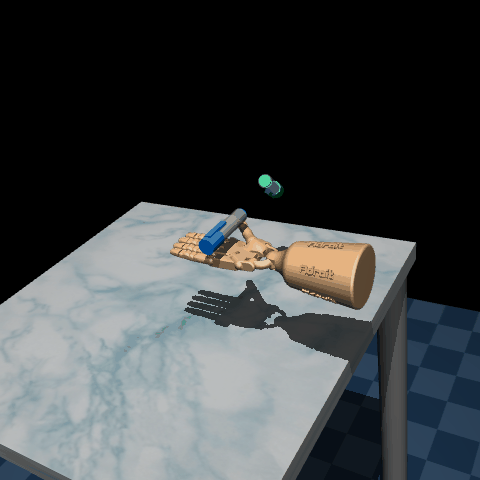

In [6]:
import matplotlib.pyplot as plt
import imageio
from IPython.display import Image

env = dataset.recover_environment(render_mode="rgb_array", camera_id=2)

episode = next(dataset.iterate_episodes())

frames = []
env.reset()

random_actions = True

if random_actions:
    # random actions
    for _ in range(500):
        _, _, terminated, truncated, _ = env.step(dataset.action_space.sample())
        frames.append(env.render())
else:
    # action of the episode 
    for action in episode.actions:
        _, _, terminated, truncated, i = env.step(action)
        frames.append(env.render())
        if terminated or truncated:
            print("Terminated" if terminated else "Truncated")
            break

env.close()

imageio.mimsave("../gifs/pen_demo.gif", frames, duration=1/30)
Image(filename="../gifs/pen_demo.gif")

# Caricamento del dataset Relocate


Il task "recolacare" richiede a una mano robotica (Adroit Hand) di manipolare una pallina per portarla in una certa posizione nello spazio.

In [7]:
import minari

In [8]:
dataset = minari.load_dataset("D4RL/relocate/expert-v2")

In [9]:
print("Episodi totali:", dataset.total_episodes)
print("Spazio osservazioni:", dataset.observation_space)
print("Spazio azioni:", dataset.action_space)

Episodi totali: 5000
Spazio osservazioni: Box(-inf, inf, (39,), float64)
Spazio azioni: Box(-1.0, 1.0, (30,), float32)


Ogni episodio contiene:

- `observations`: vettori da 39 dimensioni (stato della mano, pallina e target: posizioni, velocità e orientamenti)
- `actions`: vettori da 24 dimensioni (comandi ai giunti della mano e della posizione della mano)
- `rewards`: scalari per ogni passo
- `terminations`: flag booleani (successo)
- `truncations`: flag booleani (interruzione per timeout)

Questo dataset rappresenta dati raccolti da una policy esperta.

Spiegazione di ogni campo dei vettori del dataset:
https://robotics.farama.org/envs/adroit_hand/adroit_relocate/

In [10]:
episode = next(dataset.iterate_episodes())
print(episode)

print(f"Osservazioni: \n{episode.observations[0]}")
print(f"Actions: \n{episode.actions[0]}")
print(f"Rewards: \n{episode.rewards[0]}")
print(f"Terminations: \n{episode.terminations[0]}")

EpisodeData(id=0, total_steps=200, observations=ndarray of shape (201, 39) and dtype float64, actions=ndarray of shape (200, 30) and dtype float32, rewards=ndarray of 200 floats, terminations=ndarray of 200 bools, truncations=ndarray of 200 bools, infos=dict with the following keys: ['success'])
Osservazioni: 
[ 0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.          0.
  0.10688525 -0.4088098   0.11586687 -0.13682226 -0.07722782 -0.17972529
 -0.24370751  0.33158198 -0.29559216]
Actions: 
[-0.1811433  -1.          0.06145284 -0.08685581  0.01325034 -0.07169931
  0.7560448  -0.06278839 -0.11675381  0.06746203 -0.00791922 -0.9024085
 -0.06708331 -0.96471375 -1.         -0.63426626 -0.5339223  -0.5425988
  0.40173542  0.27555844 

The task to be completed consists on repositioning the blue pen to match the orientation of the green target. The base of the hand is fixed. The target is also randomized to cover all configurations. The task will be considered successful when the orientations match within tolerance

# Visualizzazione di un episodio

## Apertura simulatore MuJoCo

In [11]:
env = dataset.recover_environment(render_mode="human", camera_id=4)

episode = next(dataset.iterate_episodes())

env.reset()

random_actions = False

if random_actions:
    # random actions
    for _ in range(500):
        _, _, terminated, truncated, _ = env.step(dataset.action_space.sample())
else:
    # action of the episode 
    for action in episode.actions:
        _, _, terminated, truncated, i = env.step(action)
        if terminated or truncated:
            print("Terminated" if terminated else "Truncated")
            break

env.close()

Truncated


## Salvataggio gif

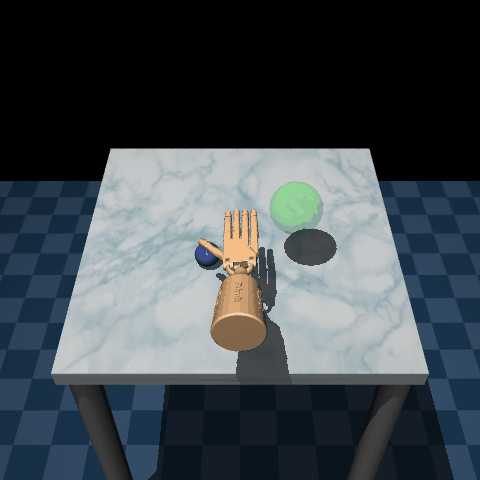

In [12]:
import matplotlib.pyplot as plt
import imageio
from IPython.display import Image

env = dataset.recover_environment(render_mode="rgb_array", camera_id=1)

episode = next(dataset.iterate_episodes())

frames = []
env.reset()

random_actions = True

if random_actions:
    # random actions
    for _ in range(500):
        _, _, terminated, truncated, _ = env.step(dataset.action_space.sample())
        frames.append(env.render())
else:
    # action of the episode 
    for action in episode.actions:
        _, _, terminated, truncated, i = env.step(action)
        frames.append(env.render())
        if terminated or truncated:
            print("Terminated" if terminated else "Truncated")
            break

env.close()

imageio.mimsave("../gifs/relocate_demo.gif", frames, duration=1/30)
Image(filename="../gifs/relocate_demo.gif")